# load  libraries

In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

# we apply feature scaling when whole data convert to number format

In [2]:
df=pd.read_csv("C:\\Users\\Mr\\Desktop\\location\\Mental Health Dataset.csv",parse_dates=['Timestamp'])

In [3]:
df.head(6)

,Timestamp,Gender,Country,Occupation,self_employed,family_history,treatment,Days_Indoors,Growing_Stress,Changes_Habits,Mental_Health_History,Mood_Swings,Coping_Struggles,Work_Interest,Social_Weakness,mental_health_interview,care_options
0,2014-08-27 11:29:00,Female,United States,Corporate,NaN,No,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,No,Not sure
1,2014-08-27 11:31:00,Female,United States,Corporate,NaN,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,No,No
2,2014-08-27 11:32:00,Female,United States,Corporate,NaN,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,No,Yes
3,2014-08-27 11:37:00,Female,United States,Corporate,No,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,Maybe,Yes
4,2014-08-27 11:43:00,Female,United States,Corporate,No,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,No,Yes
5,2014-08-27 11:49:00,Female,Poland,Corporate,No,No,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,Maybe,Not sure


# maximum rows and columns

In [4]:
pd.set_option("display.max_rows",None)
pd.set_option("display.max_columns",None)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292364 entries, 0 to 292363
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   Timestamp                292364 non-null  datetime64[ns]
 1   Gender                   292364 non-null  object        
 2   Country                  270489 non-null  object        
 3   Occupation               292364 non-null  object        
 4   self_employed            287162 non-null  object        
 5   family_history           292364 non-null  object        
 6   treatment                292364 non-null  object        
 7   Days_Indoors             292364 non-null  object        
 8   Growing_Stress           292364 non-null  object        
 9   Changes_Habits           292364 non-null  object        
 10  Mental_Health_History    292364 non-null  object        
 11  Mood_Swings              292364 non-null  object        
 12  Coping_Struggles

In [6]:
df['Growing_Stress'].value_counts().unique

<bound method Series.unique of Growing_Stress
Maybe    99985
Yes      99653
No       92726
Name: count, dtype: int64>

In [7]:
df.isnull().sum()

Timestamp                      0
Gender                         0
Country                    21875
Occupation                     0
self_employed               5202
family_history                 0
treatment                      0
Days_Indoors                   0
Growing_Stress                 0
Changes_Habits                 0
Mental_Health_History          0
Mood_Swings                    0
Coping_Struggles               0
Work_Interest                  0
Social_Weakness                0
mental_health_interview        0
care_options                   0
dtype: int64

In [8]:
df=df.drop(columns=df[['mental_health_interview','Timestamp']])

<Axes: >

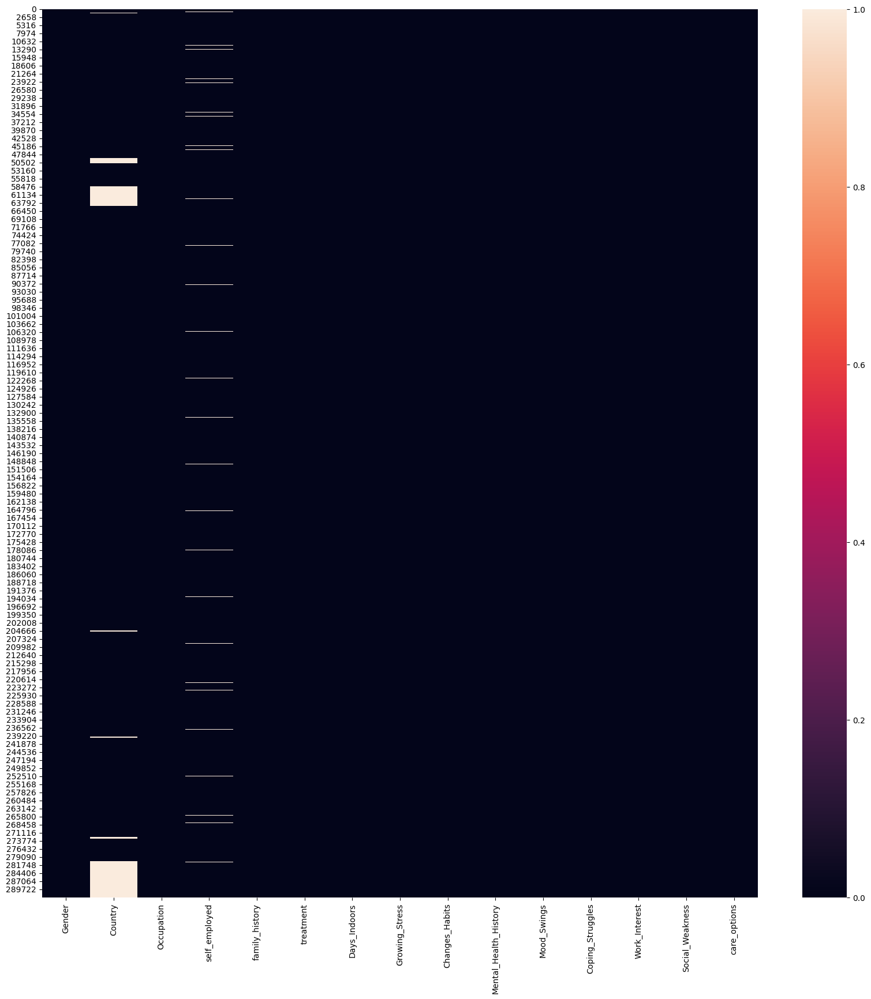

In [9]:
plt.figure(figsize=(20,20))
sns.heatmap(df.isnull())

# we calculate percentage of missing data

In [10]:
null_var=df.isnull().sum()/df.shape[0]*100
null_var

Gender                   0.000000
Country                  7.482111
Occupation               0.000000
self_employed            1.779289
family_history           0.000000
treatment                0.000000
Days_Indoors             0.000000
Growing_Stress           0.000000
Changes_Habits           0.000000
Mental_Health_History    0.000000
Mood_Swings              0.000000
Coping_Struggles         0.000000
Work_Interest            0.000000
Social_Weakness          0.000000
care_options             0.000000
dtype: float64

## first we check which columns have missing value more than 5%

In [11]:
drop_columns=null_var[null_var>5].keys()
drop_columns

Index(['Country'], dtype='object')

## we drop column which has more missing value than 5%

In [12]:
df2_drop_col=df.drop(columns=drop_columns)

In [13]:
df2_drop_col.shape

(292364, 14)

<Axes: >

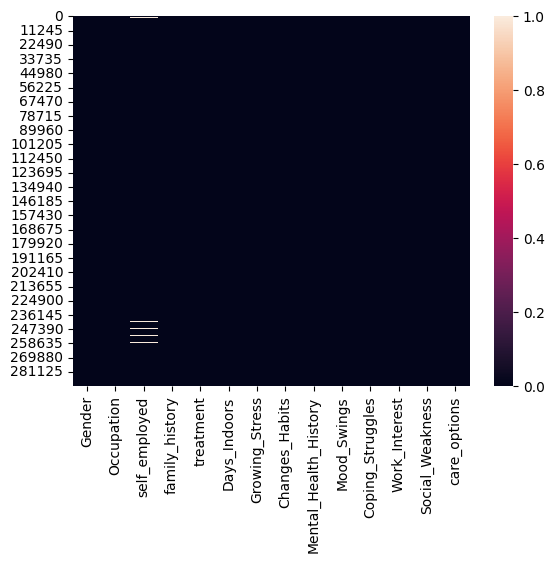

In [14]:
sns.heatmap(df2_drop_col.isnull())

# droping rows which have even single null value

In [15]:
df3_drop_rows=df2_drop_col.dropna()

In [16]:
df3_drop_rows.isnull().sum()

Gender                   0
Occupation               0
self_employed            0
family_history           0
treatment                0
Days_Indoors             0
Growing_Stress           0
Changes_Habits           0
Mental_Health_History    0
Mood_Swings              0
Coping_Struggles         0
Work_Interest            0
Social_Weakness          0
care_options             0
dtype: int64

In [17]:
df3_drop_rows.shape

(287162, 14)

<Axes: >

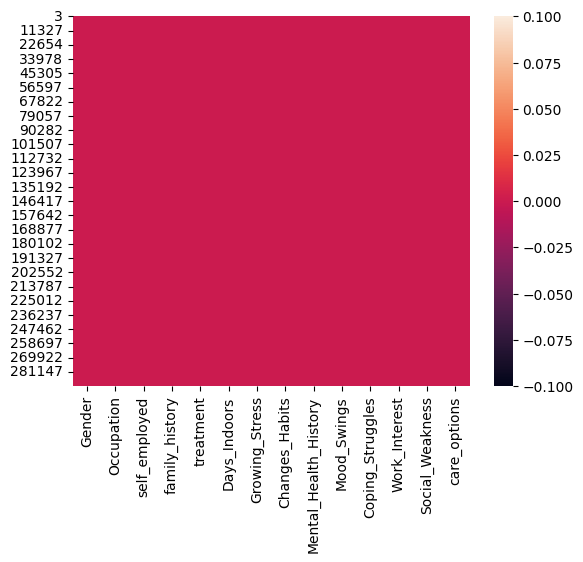

In [18]:
sns.heatmap(df3_drop_rows.isnull())

In [19]:
df3_drop_rows.isnull().sum()

Gender                   0
Occupation               0
self_employed            0
family_history           0
treatment                0
Days_Indoors             0
Growing_Stress           0
Changes_Habits           0
Mental_Health_History    0
Mood_Swings              0
Coping_Struggles         0
Work_Interest            0
Social_Weakness          0
care_options             0
dtype: int64

In [20]:
df3_drop_rows.isnull().sum().sum()

0

In [21]:
df3_drop_rows.head()

,Gender,Occupation,self_employed,family_history,treatment,Days_Indoors,Growing_Stress,Changes_Habits,Mental_Health_History,Mood_Swings,Coping_Struggles,Work_Interest,Social_Weakness,care_options
3,Female,Corporate,No,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,Yes
4,Female,Corporate,No,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,Yes
5,Female,Corporate,No,No,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,Not sure
6,Female,Corporate,No,Yes,Yes,1-14 days,Yes,No,Yes,Medium,No,No,Yes,Not sure
7,Female,Corporate,No,No,No,1-14 days,Yes,No,Yes,Medium,No,No,Yes,No


In [22]:
df2=df3_drop_rows[['Mood_Swings','Work_Interest','Days_Indoors','Growing_Stress']]

# this method select columns which have integer and float values

In [23]:
df3_drop_rows.select_dtypes(include=['int64','float64']).columns

Index([], dtype='object')

In [24]:
dumy_datafrm=pd.get_dummies(df3_drop_rows[['Gender','Occupation','self_employed','family_history','treatment','Social_Weakness','Coping_Struggles']],drop_first=True)


In [25]:
dumy_datafrm = dumy_datafrm.rename(columns={'Gender_Male': 'gender'})


In [26]:
dumy_datafrm.shape

(287162, 11)

In [27]:
dum_featur=dumy_datafrm.keys()

In [28]:
dum_featur

Index(['gender', 'Occupation_Corporate', 'Occupation_Housewife',
       'Occupation_Others', 'Occupation_Student', 'self_employed_Yes',
       'family_history_Yes', 'treatment_Yes', 'Social_Weakness_No',
       'Social_Weakness_Yes', 'Coping_Struggles_Yes'],
      dtype='object')

In [29]:
#dumy_datafrm = pd.DataFrame(dumy_datafrm, columns=['dum_featur'])

In [30]:
dumy_datafrm.to_csv("dum_data.csv",index=False)

columns_to_encode = ['Gender', 'Occupation', 'self_employed', 'family_history', 'treatment','Growing_Stress', 'Social_Weakness', 'Coping_Struggles']
df3_drop_rows = pd.DataFrame({
    'Gender': ['Male', 'Female', 'Female', 'Male'],
    'Occupation': ['Student', 'Corporate', 'Housewife', 'Others'],
    'self_employed': ['No', 'Yes', 'No', 'Yes'],
    'family_history': ['No', 'Yes', 'No', 'Yes'],
    'treatment': ['No', 'Yes', 'No', 'Yes'],
    'Growing_Stress': ['Yes', 'No', 'Yes', 'No'],
   'Social_Weakness': ['No', 'Yes', 'No', 'Yes'],
    'Coping_Struggles': ['Yes', 'No', 'Yes', 'No']})

# one hot encoding on nominal variable

In [31]:
#from sklearn.preprocessing import OneHotEncoder

In [32]:
#oh_enc = OneHotEncoder(drop='first')
#oh_enc_arr = oh_enc.fit_transform(df3_drop_rows[columns_to_encode]).toarray()

In [33]:
#oh_enc_arr

In [34]:
#column_names = oh_enc.get_feature_names_out(columns_to_encode)

In [35]:
#oh_enc_df=pd.DataFrame(oh_enc_arr,columns=column_names)
#oh_enc_df

In [36]:
#oh_enc_df.dtypes

In [37]:
df3_drop_rows.self_employed.value_counts().unique

<bound method Series.unique of self_employed
No     257994
Yes     29168
Name: count, dtype: int64>

In [38]:
#df_featur=['Gender_Male', 'Occupation_Housewife', 'Occupation_Others','Occupation_Student', 'self_employed_Yes', 'family_history_Yes','treatment_Yes', 'Growing_Stress_Yes', 'Social_Weakness_Yes',
#'Coping_Struggles_Yes']

# use of label encoding and ordinal encoding on mood swings and work interest

In [39]:
from sklearn.preprocessing import LabelEncoder

In [40]:
pd.set_option("display.max_rows",None)

In [41]:
df2.shape

(287162, 4)

In [42]:
le=LabelEncoder()
df2['Mood_Swings_le']=le.fit_transform(df2['Mood_Swings'])

df2['Growing_Stress']=le.fit_transform(df2['Growing_Stress'])

C:\Users\Mr\AppData\Local\Temp\ipykernel_14300\3609883097.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Mood_Swings_le']=le.fit_transform(df2['Mood_Swings'])
C:\Users\Mr\AppData\Local\Temp\ipykernel_14300\3609883097.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Growing_Stress']=le.fit_transform(df2['Growing_Stress'])


In [43]:
df2['Growing_Stress'].value_counts().unique

<bound method Series.unique of Growing_Stress
0    98225
2    97854
1    91083
Name: count, dtype: int64>

In [44]:
df2['Work_Interest'].unique()

array(['No', 'Maybe', 'Yes'], dtype=object)

In [45]:
df2['Days_Indoors'].unique()

array(['1-14 days', 'Go out Every day', 'More than 2 months',
       '15-30 days', '31-60 days'], dtype=object)

In [46]:
order_Label={'1-14 days':4, 'Go out Every day':5, 'More than 2 months':3,
              '15-30 days':2,'31-60 days':1}

In [47]:
df2['Days_Indoors_le']=df2['Days_Indoors'].map(order_Label)

C:\Users\Mr\AppData\Local\Temp\ipykernel_14300\482489453.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Days_Indoors_le']=df2['Days_Indoors'].map(order_Label)


In [48]:
order_Label2={'No':0, 'Maybe':1, 'Yes':2}

In [49]:
df2['Work_Interest_le']=df2['Work_Interest'].map(order_Label2)

C:\Users\Mr\AppData\Local\Temp\ipykernel_14300\2447755510.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Work_Interest_le']=df2['Work_Interest'].map(order_Label2)


In [50]:
df2.shape

(287162, 7)

In [51]:
df2.head()

,Mood_Swings,Work_Interest,Days_Indoors,Growing_Stress,Mood_Swings_le,Days_Indoors_le,Work_Interest_le
3,Medium,No,1-14 days,2,2,4,0
4,Medium,No,1-14 days,2,2,4,0
5,Medium,No,1-14 days,2,2,4,0
6,Medium,No,1-14 days,2,2,4,0
7,Medium,No,1-14 days,2,2,4,0


In [52]:
#df2=df2.drop(columns=['Mood_Swings','Work_Interest','Days_Indoors'])

In [53]:
print(df2.shape)







(287162, 7)


In [54]:
print(df2)

       Mood_Swings Work_Interest        Days_Indoors  Growing_Stress  \
3           Medium            No           1-14 days               2   
4           Medium            No           1-14 days               2   
5           Medium            No           1-14 days               2   
6           Medium            No           1-14 days               2   
7           Medium            No           1-14 days               2   
8           Medium            No           1-14 days               2   
9           Medium            No           1-14 days               2   
10          Medium            No           1-14 days               2   
11          Medium            No           1-14 days               2   
12          Medium            No           1-14 days               2   
13          Medium            No           1-14 days               2   
14          Medium            No           1-14 days               2   
15          Medium            No           1-14 days            

In [55]:
#df2_featur=[['Mood_Swings_le','Days_Indoors_le','Work_Interest_le']]

In [56]:
#df=pd.DataFrame(np.c_[b_cancer['data'],b_cancer['target']],columns=np.append(b_cancer['feature_names'],['target']))

In [57]:
print(df2.shape)

(287162, 7)


# making data fram

In [58]:
df2 = pd.DataFrame(df2, columns=['Growing_Stress','Mood_Swings_le','Days_Indoors_le','Work_Interest_le'])

In [59]:
df2.head()

,Growing_Stress,Mood_Swings_le,Days_Indoors_le,Work_Interest_le
3,2,2,4,0
4,2,2,4,0
5,2,2,4,0
6,2,2,4,0
7,2,2,4,0


In [60]:
import pandas as pd

df2.to_csv("df2.csv", index=False)


In [61]:
#df3=pd.DataFrame(np.c_[dumy_datafrm,df2],columns=np.append(dumy_datafrm['dum_featur'],df2['df2_featur']))

In [62]:
import pandas as pd
import numpy as np

# Ensure dumy_datafrm and df2 are already defined as DataFrames
# For example:
# dumy_datafrm = pd.DataFrame(dumy_datafrm, columns=['dum_featur'])
# df2 = pd.DataFrame(data2, columns=['df2_featur'])

# Concatenate the DataFrames
combined_data = np.c_[dumy_datafrm.values, df2.values]

# Define the columns
combined_columns = np.append(dumy_datafrm.columns, df2.columns)

# Create the new DataFrame
df3 = pd.DataFrame(combined_data,columns=combined_columns)


In [63]:
df3.head()

,gender,Occupation_Corporate,Occupation_Housewife,Occupation_Others,Occupation_Student,self_employed_Yes,family_history_Yes,treatment_Yes,Social_Weakness_No,Social_Weakness_Yes,Coping_Struggles_Yes,Growing_Stress,Mood_Swings_le,Days_Indoors_le,Work_Interest_le
0,0,1,0,0,0,0,1,1,0,1,0,2,2,4,0
1,0,1,0,0,0,0,1,1,0,1,0,2,2,4,0
2,0,1,0,0,0,0,0,1,0,1,0,2,2,4,0
3,0,1,0,0,0,0,1,1,0,1,0,2,2,4,0
4,0,1,0,0,0,0,0,0,0,1,0,2,2,4,0


In [65]:
df3.to_csv("mental_health.csv",index=False)